# Task 1: Filters Visualization
## 1.1 - Load VGG16
We are loading a (pretrained) VGG16 via torchvision

In [66]:
import os
import random
import matplotlib.pyplot as plt

from PIL import Image

import torch
from torch.optim import Adam
from torchvision import models

from filters_visualization import visualise_layer_filter

RESULTS_DIR = 'results'
os.makedirs(RESULTS_DIR, exist_ok=True)

In [4]:
# Initialize GPU if available
use_gpu = False
if torch.cuda.is_available():
    use_gpu = True
    print('GPU is available')
else:
    print('GPU is not available')

# Set the seed for reproducibility
seed = 42
random.seed(seed)
torch.manual_seed(seed)

# Select device to work on.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# 1.1 load the pretrained VGG16 network
model = models.vgg16(pretrained=True)

GPU is not available


## 1.2 - Optimize input image

* Familiarize yourself with the code in file filters_visualization.py. 
* Print the shape,mean, minimum and maximum of the intermediate network-activations

-----------------------------------------------------
What we are doing in visualise_layer_filter:
Given an image $I \in \mathbb{R}^{h \times w \times 3}$, we want to maximize the mean activation of our (frozen) VGG-network $\phi$ at a given layer $\ell$ and a filter $f$:
$$I^* = \ \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmax}} \frac{1}{w\cdot h}\sum_{i,j} \phi(I)^{(\ell, f)}_{i,j}$$
$$= \ \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmin}} \Big[-\frac{1}{w\cdot h}\sum_{i,j} \phi(I)^{(\ell, f)}_{i,j}\Big]$$
We choose $I \sim \mathcal{U}[120, 190]$ as an initial image.

In [22]:
import numpy as np
from aux_ops import preprocess_image, recreate_image
    
# we generate a simple (random) image to obtain activation-values.
rand_img = np.uint8(np.random.uniform(low=120,
                                      high=190,
                                      size=(224, 224, 3)))

processed_image = preprocess_image(rand_img, False)
processed_image = torch.tensor(processed_image, device=device).float()
processed_image.requires_grad = True

activation = processed_image

for index, layer in enumerate(model):
    # Forward-pass layer by layer
    print(f"In layer {index}: {activation.shape}", 
          f"\ttype {layer}" # optional: print the type of the layer
          f"\tmin: {activation.min().cpu().detach():0.2f}",
          f"\tmean: {activation.mean().cpu().detach():0.2f}",
          f"\tmax: {activation.max().cpu().detach():0.2f}"
          )
    
    # Pass the image/activation through the layer
    activation = layer(activation)

/var/folders/4h/v0fwv1zs4596mmdvwj516k840000gn/T/ipykernel_83132/2729846715.py:10: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


In layer 0: torch.Size([1, 3, 224, 224]) 	type Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))	min: -0.06 	mean: 0.69 	max: 1.49
In layer 1: torch.Size([1, 64, 224, 224]) 	type ReLU(inplace=True)	min: -3.95 	mean: -0.07 	max: 4.74
In layer 2: torch.Size([1, 64, 224, 224]) 	type Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))	min: 0.00 	mean: 0.27 	max: 4.74
In layer 3: torch.Size([1, 64, 224, 224]) 	type ReLU(inplace=True)	min: -13.97 	mean: -0.27 	max: 13.43
In layer 4: torch.Size([1, 64, 224, 224]) 	type MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)	min: 0.00 	mean: 0.57 	max: 13.43
In layer 5: torch.Size([1, 64, 112, 112]) 	type Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))	min: 0.00 	mean: 1.29 	max: 13.43
In layer 6: torch.Size([1, 128, 112, 112]) 	type ReLU(inplace=True)	min: -25.66 	mean: -1.74 	max: 17.44
In layer 7: torch.Size([1, 128, 112, 112]) 	type Conv2d(128, 128, kernel_size=(3, 3), stri

## Task 1.3 - Visualize a random filter.

Step 00020. Loss:-74.61


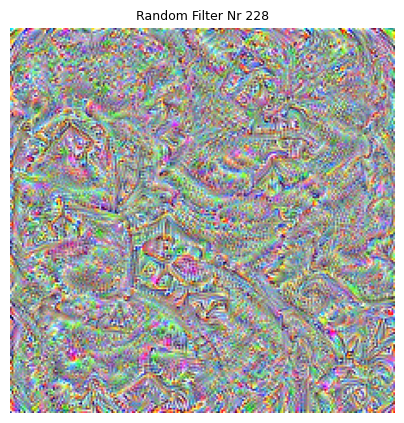

In [28]:
# Change the input image values in order to maximize output activation

layer_nmbr = 28
filter_nmbr = 228

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

# Fix model weights
for param in model.parameters():
    param.requires_grad = False
    
# Enable GPU
if use_gpu:
    model.cuda()

# use this output in some way
layer_img = visualise_layer_filter(model, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

# Visualize a random filter.
plt.figure(figsize=(5,5))
plt.imshow(layer_img)
plt.title('Random Filter Nr {}'.format(filter_nmbr), fontsize=9)
plt.savefig(os.path.join(RESULTS_DIR, 'filter_{}_{}.png'.format(layer_nmbr, filter_nmbr)))
plt.axis('off')
plt.show()

Step 00020. Loss:-26.50


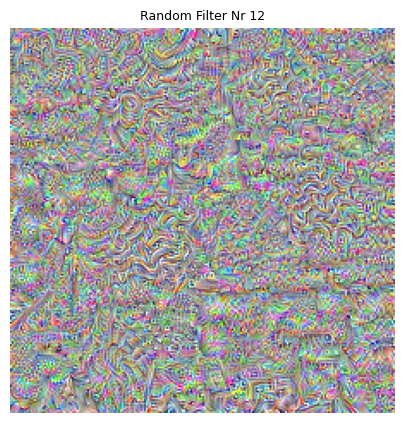

In [29]:
layer_nmbr = 28
filter_nmbr = 12

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

# Fix model weights
for param in model.parameters():
    param.requires_grad = False
    
# Enable GPU
if use_gpu:
    model.cuda()

# use this output in some way
layer_img = visualise_layer_filter(model, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

# Visualize a random filter.
plt.figure(figsize=(5,5))
plt.imshow(layer_img)
plt.title('Random Filter Nr {}'.format(filter_nmbr), fontsize=9)
plt.savefig(os.path.join(RESULTS_DIR, 'filter_{}_{}.png'.format(layer_nmbr, filter_nmbr)))
plt.axis('off')
plt.show()

## Task 1.4 - Visualize filters at different layers.

In [38]:
layer_nmbr = 28
filter_nmbr = 6

# Visualize filters at different layers.
selected_layer_numbers = [1, 8, 13, 20, 28]
selected_filter_numbers = sorted(np.random.choice(64, 5,replace=False))

layer_filters = []

for layer_nmbr in selected_layer_numbers:
    for filter_nmbr in selected_filter_numbers:
        # use this output in some way
        layer_img = visualise_layer_filter(model, 
                                           layer_nmbr=layer_nmbr, 
                                           filter_nmbr=filter_nmbr, 
                                           num_optim_steps=32)
        layer_filters.append(layer_img)

/Volumes/Work Disk Janina Mattes/DEV/University/GAI/GAI-Visual-Synthesis/05_CNN_filters_vis/filters_visualization.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


Step 00020. Loss:-2.69
Step 00020. Loss:-2.77
Step 00020. Loss:-1.52
Step 00020. Loss:-2.52
Step 00020. Loss:-2.15
Step 00020. Loss:-26.21
Step 00020. Loss:-25.02
Step 00020. Loss:-16.51
Step 00020. Loss:-41.86
Step 00020. Loss:-20.17
Step 00020. Loss:-86.52
Step 00020. Loss:-62.78
Step 00020. Loss:-65.35
Step 00020. Loss:-72.15
Step 00020. Loss:-121.17
Step 00020. Loss:-101.69
Step 00020. Loss:-101.74
Step 00020. Loss:-66.24
Step 00020. Loss:-103.82
Step 00020. Loss:-39.12
Step 00020. Loss:-75.26
Step 00020. Loss:-91.13
Step 00020. Loss:-96.22
Step 00020. Loss:-60.20
Step 00020. Loss:-90.87


In [41]:
def plot_filters(collect_filters, selected_layer_numbers, selected_filter_numbers, plt_name='filter_grid.png'):
    # Plot filters in a grid with 5 columns
    fig, axs = plt.subplots(len(selected_layer_numbers), len(selected_filter_numbers), figsize=(15, 15))
    for i, layer_img in enumerate(collect_filters):
        row = i // len(selected_filter_numbers)
        col = i % len(selected_filter_numbers)
        axs[row, col].imshow(layer_img)
        axs[row, col].axis('off')
        axs[row, col].set_title(f'Layer {selected_layer_numbers[row]} Filter {selected_filter_numbers[col]}')
    plt.savefig(os.path.join(RESULTS_DIR, plt_name))
    plt.show()

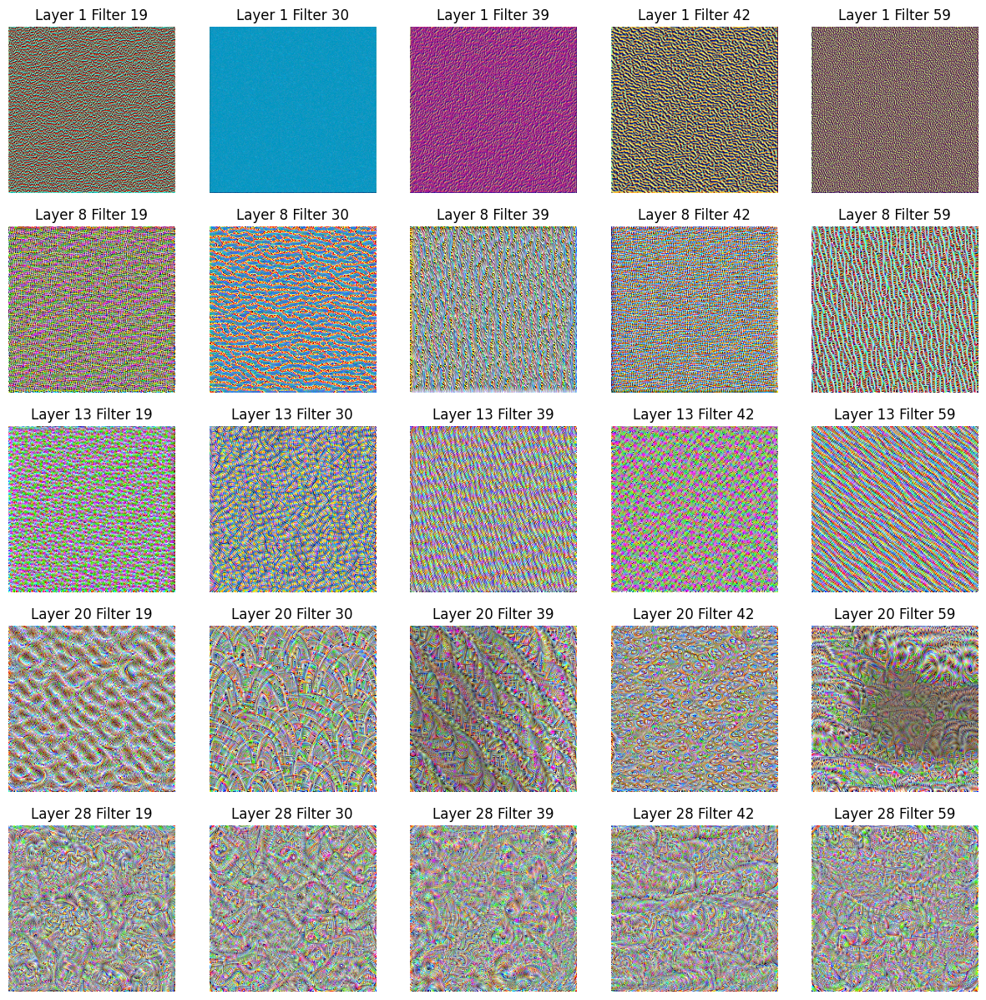

In [42]:
plot_filters(layer_filters, selected_layer_numbers, selected_filter_numbers)

**What do you observe going from earlier layers to later layers?**

* In the earlier layers of the pre-trained network, filters were learned that mainly represent local, simple and common visual elements such as edges, corners, and textures.  These elements are often low-level and specific to the input images.

* In later layers filters were learned that represent more complex and abstract visual concepts such as shapes, objects, and their spatial relationships. Such concepts are often high-level and can be comprised to global features of the input images.

* The receptive field of the filters, which is the region of the input image that affects the output of the filter, increases seemingly with later layers. This allows the later filters to capture more contextual information and long-range dependencies in the input images.

* Thereby, the hierarchical nature of the convolutional neural network enables the network to learn a more diverse set of features at different levels of abstraction.

## Task 1.5 - Hyperparameter tuning.

The process of visualization is quite sensitive to the
parameters. Some of the crucial parameters to tune are
* the number of optimization steps num_optim_steps
* the learning rate lr
* the optimizer

Vary those and describe what you see.


### 1.5.1 Train with differing number of optimization steps


In [11]:
layer_nmbr = 28
filter_nmbr = 228

num_optim_steps = [8, 16, 32, 64, 75, 128]
collect_filters = []

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

for steps in num_optim_steps:
    optimized_img = visualise_layer_filter(model, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=steps)
    collect_filters.append(optimized_img)


/Users/janinaalicamattes/miniforge3/envs/pytorch-py11/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/janinaalicamattes/miniforge3/envs/pytorch-py11/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/Volumes/Work Disk Janina Mattes/DEV/University/GAI/GAI-Visual-Synthesis/05_CNN_filters_vis/filters_visualization.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.te

Step 00020. Loss:-76.48
Step 00020. Loss:-77.72
Step 00040. Loss:-197.63
Step 00060. Loss:-340.20
Step 00020. Loss:-81.20
Step 00040. Loss:-195.80
Step 00060. Loss:-327.33
Step 00020. Loss:-75.43
Step 00040. Loss:-178.89
Step 00060. Loss:-302.24
Step 00080. Loss:-441.35
Step 00100. Loss:-591.25
Step 00120. Loss:-747.94


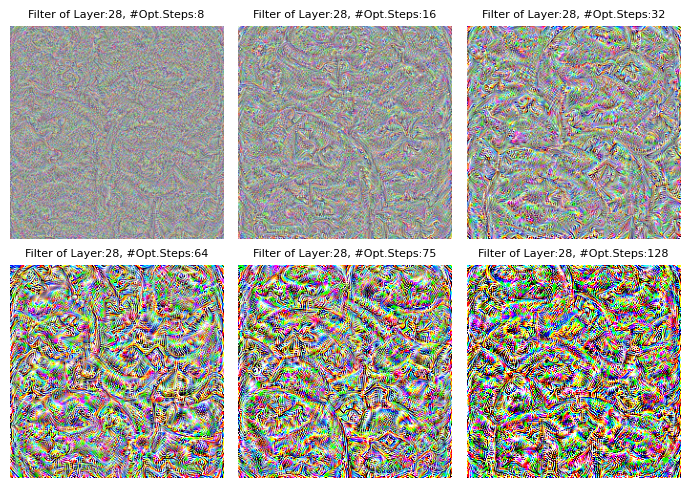

In [12]:
# Set the number of columns and rows
n_cols = 3
n = len(collect_filters)
n_rows = (n - 1) // n_cols + 1

plt_name = 'filter_grid_steps.png'

# Plot filters in a grid
plt.figure(figsize=(7, 5))
for i, img in enumerate(collect_filters):
    # Adjust the subplot parameters to plot three images in one row
    plt.subplot(n_rows, n_cols, i + 1)
    plt.title('Filter of Layer:28, #Opt.Steps:{}'.format(num_optim_steps[i]), fontsize=8)
    plt.imshow(img, cmap='gray')
    plt.axis('off')

plt.tight_layout()
plt.savefig(os.path.join(RESULTS_DIR, plt_name))
plt.show()

**1.5.2 Train with differing number of learning rate**

In [10]:
learning_rates = [0.4, 0.3, 0.2, 0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001]
collect_filters = []

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

for lr in learning_rates:
    optimized_img = visualise_layer_filter(model, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, lr=lr)
    collect_filters.append(optimized_img)

Step 00020. Loss:-225.60
Step 00020. Loss:-194.72
Step 00020. Loss:-132.10
Step 00020. Loss:-85.64
Step 00020. Loss:-13.04
Step 00020. Loss:-0.51
Step 00020. Loss:1.58
Step 00020. Loss:1.64
Step 00020. Loss:1.79


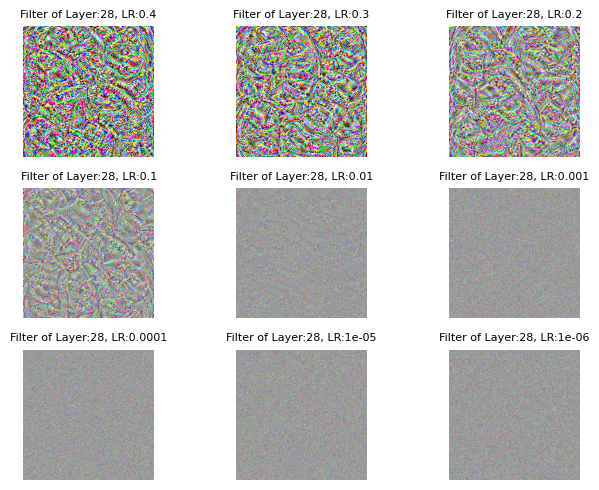

In [11]:
# Set the number of columns and rows
n_cols = 3
n = len(collect_filters)
n_rows = (n - 1) // n_cols + 1

plt_name = 'filter_grid_lr.png'

# Plot filters in a grid
plt.figure(figsize=(7, 5))
for i, img in enumerate(collect_filters):
    # Adjust the subplot parameters to plot three images in one row
    plt.subplot(n_rows, n_cols, i + 1)
    plt.title('Filter of Layer:28, LR:{}'.format(learning_rates[i]), fontsize=8)
    plt.imshow(img, cmap='gray')
    plt.axis('off')

plt.tight_layout()
plt.savefig(os.path.join(RESULTS_DIR, plt_name))
plt.show()

**1.5.3 Train with differing type of optimizer**

In [12]:
optimizer_types = ['rmsprop','adam', 'adamax', 'sgd', 'asgd', 'adagrad',]
collect_filters = []

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

for optim in optimizer_types:
    optimized_img = visualise_layer_filter(model, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, optimizer_type=optim)
    collect_filters.append(optimized_img)

Step 00020. Loss:-287.51
Step 00020. Loss:-73.85
Step 00020. Loss:-55.66
Step 00020. Loss:1.18
Step 00020. Loss:1.32
Step 00020. Loss:-54.79


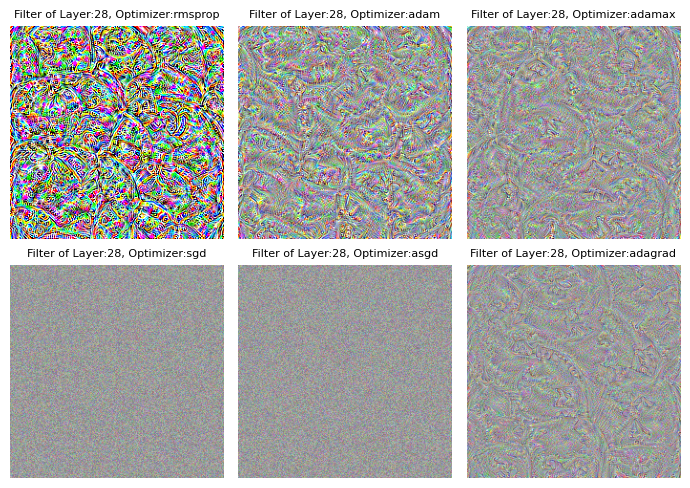

In [13]:
# Set the number of columns and rows
n_cols = 3
n = len(collect_filters)
n_rows = (n - 1) // n_cols + 1

plt_name = 'filter_grid_optim.png'

# Plot filters in a grid
plt.figure(figsize=(7, 5))
for i, img in enumerate(collect_filters):
    # Adjust the subplot parameters to plot three images in one row
    plt.subplot(n_rows, n_cols, i + 1)
    plt.title('Filter of Layer:28, Optimizer:{}'.format(optimizer_types[i]), fontsize=8)
    plt.imshow(img, cmap='gray')
    plt.axis('off')

plt.tight_layout()
plt.savefig(os.path.join(RESULTS_DIR, plt_name))
plt.show()

**What do you observe?**


In Summary: <br>
* Higher contrast for a higher learning rate
* Structures in image changes

Further: <br>
In this experiment, a random distribution of pixels is generated and a pre-trained convolutional neural network (VGG16) is used to synthesize visual textures that maximize the activation of a selected filter. This is achieved by computing the mean activation of the filter and the gradient of the image with respect to the mean activation, and then updating the image using an optimizer to minimize the distance between them.

During the experiment, hyperparameter tuning was performed by increasing the number of optimization steps, using varying learning rates, and training with different optimizers.

* It was observed that the more optimization steps performed, the more the learned patterns of the selected filters influenced the output patterns on the previously randomly generated image. This is likely due to the more frequently repeated gradient step during backpropagation, which updates the filter weights to better match the desired pattern.
* Additionally, larger learning rates result in more clearly enhanced patterns on the random input image. This is because a larger learning rate allows the filter weights to be updated more aggressively, leading to a faster and more pronounced convergence to the desired pattern.
* It was also observed that optimizers such as RMSprop and those in the Adam family resulted in more visible patterns, while optimizers in the SGD family had a lesser visible effect. This may be due to the fact that RMSprop and Adam have adaptive learning rates, which can help to better optimize the network for the specific task of pattern enhancement. The adaptive learning rates allow for more fine-grained updates to the filter weights, leading to a more detailed and accurate convergence to output the desired pattern based on a selected filter.

### 1.5.4 Different Image Initialization

* Another important parameter is the input image rand_img initialization
* Change low and high values used for initialization and describe what you see. 
* Try out an image filled with the value 128. 

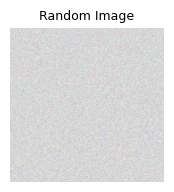

Step 00020. Loss:-101.41


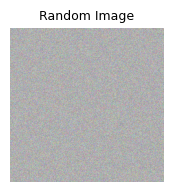

Step 00020. Loss:-81.26


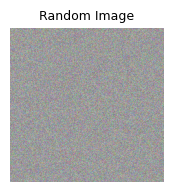

Step 00020. Loss:-86.16


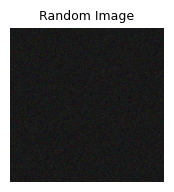

Step 00020. Loss:-87.56


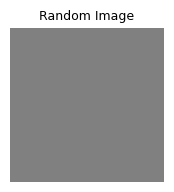

Step 00020. Loss:-59.85


In [52]:
# Create different random images
layer_nmbr = 28
filter_nmbr = 6

collect_filters = []

for rand_img in [
    np.uint8(np.random.uniform(low=240, high=190, size=(224, 224, 3))),
    np.uint8(np.random.uniform(low=150, high=200, size=(224, 224, 3))),
    np.uint8(np.random.uniform(low=120, high=190, size=(224, 224, 3))),
    np.uint8(np.random.uniform(low=10, high=40, size=(224, 224, 3))),
    np.uint8(np.random.uniform(low=128, high=128, size=(224, 224, 3)))
]:
    # Plot random images
    plt.figure(figsize=(2,2))
    plt.imshow(rand_img)
    plt.title('Random Image', fontsize=9)
    plt.axis('off')
    plt.show()

    # Create a filter for each random image
    layer_img = visualise_layer_filter(model, 
                                       layer_nmbr=layer_nmbr, 
                                       filter_nmbr=filter_nmbr, 
                                       rand_img=rand_img,
                                       num_optim_steps=32)
    collect_filters.append(layer_img)


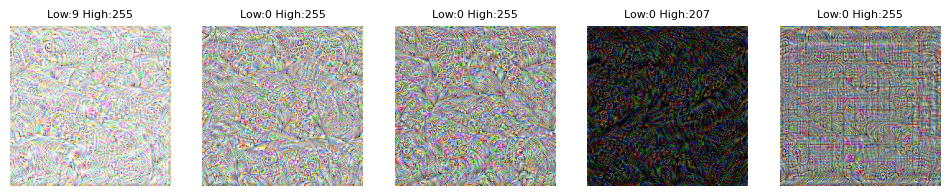

In [53]:
# Plot filters in a grid
plt.figure(figsize=(12, 8))
for i, img in enumerate(collect_filters):
    # Adjust the subplot parameters to plot three images in one row
    plt.subplot(1, 5, i + 1)
    plt.title('Low:{} High:{}'.format(img.min(), img.max()), fontsize=8)
    plt.imshow(img, cmap='gray')
    plt.axis('off')

**What can you observe?**

The output strongly depends on the initial image used. It is visible that the last image, created uniformly with ```high=128 and low=128``` values yields poorer results.

## Task 1.6 - Pretrained weights.


/Users/janinaalicamattes/miniforge3/envs/pytorch-py11/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Step 00020. Loss:-0.65


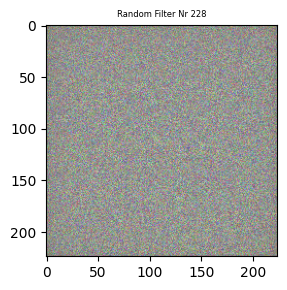

In [14]:
# Fully connected layer is not needed
model = models.vgg16(pretrained=False).features
model.eval()

# Visualize a random filter.
optimized_img = visualise_layer_filter(model, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, optimizer_type=optim)
# plot filter
plt.figure(figsize=(3,3))
plt.title('Random Filter Nr {}'.format(filter_nmbr), fontsize=6)
plt.imshow(optimized_img)

**What do you observe?**

Without pretraining, the output image is noisy. This is because the weights or filters of the model are initialized with a random distribution and have not yet learned to extract meaningful features from the input. As a result, since we try to find an image that has a distribution close to the distribution of a selected random filter, the output image generated from the initial random noise will remain in its initial state, representing a random noise distribution.

# Task 2: Deep Dream

## Task 1.1 Most activated filters for every image

* Download 5 random images
* fix particular layer. we choose layer_nmbr = 30
* select 10 most activated filters
    * Note: By "most activated filters" we actually mean the maximum activation value for each filter across its spatial dimensions (height and width).
    * More precisely, we compute $$m_{\ell, f}  :=\underset{i,j}{\operatorname{max}} \phi(I)^{(\ell, f)}_{i,j} \quad \text{for } f=1, \dots, F$$
* Then we choose 10 $f$ for the 10 highest $m_{\ell, f}$

In [80]:
# Crop size
crop_size = (224, 224)

# Load images from the data folder
images = []
for file in os.listdir('data'):
    if file.endswith('.jpeg'):
        # Load the image and convert it to RGB
        img_path = os.path.join('data', file)
        pil_img = Image.open(img_path).convert('RGB')
        
        # crop the image randomly
        width, height = pil_img.size
        left = random.randint(0, width - crop_size[0])
        top = random.randint(0, height - crop_size[1])
        right = left + crop_size[0]
        bottom = top + crop_size[1]
        pil_img = pil_img.crop((left, top, right, bottom))
        
        images.append(pil_img)

print(f"Found {len(images)} images in the data folder.")

Found 6 images in the data folder.


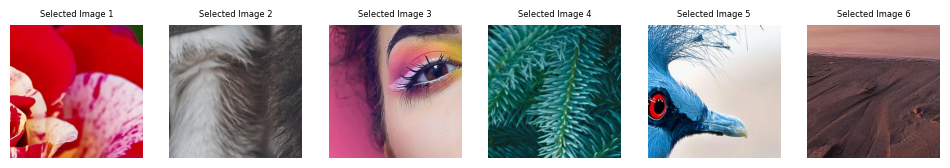

In [81]:
# plot the images
plt.figure(figsize=(12, 8))
for i, img in enumerate(images):
    plt.subplot(1, len(images), i + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(f'Selected Image {i + 1}', fontsize=6)
plt.show()

In [ ]:
# Analyze the conv_output tensor without indexing the filter with filter_nmbr
# Select the 10 most activated filters for each content image to analyse what the network sees

def visualise_10_most_activated_filters(model, input_img, layer_nmbr=22, num_optim_steps=50, lr=0.1, weight_decay=1e-6):
    
    # Process image and return variable
    processed_image = preprocess_image(input_img, resize_im=True)
    processed_image = torch.tensor(processed_image, device=device).float()
    processed_image.requires_grad = False
    
    # Assign create image to a variable to move forward in the model
    x = processed_image
    for index, layer in enumerate(model):
        # Forward pass layer by layer
        x = layer(x)
        if index == layer_nmbr:
            # Only need to forward until the selected layer is reached
            # Now, x is the output of the selected layer
            break
        
        conv_layer_output = x[0]
    
    conv_layer_output = conv_layer_output.cpu().detach().numpy()

    # Compute the most activated filters
    # (1) Compute max activation value for each filter across its spatial dimensions
    #     The result is an array of shape (num_filters,) 
    #     Each element represents the maximum activation of a filter per image sample
    max_activation_per_filter = np.max(conv_layer_output, axis=(1, 2))
    # (2) Select the top 10 filters with the highest activation values
    #     The result is an array of shape (10,)
    most_activated_filters_idcs = np.argpartition(-max_activation_per_filter, kth=range(10))[:10]
    # Sort the filters by their filter number
    most_activated_filters_idcs = np.sort(most_activated_filters_idcs)

    # Plot initial image
    plt.figure(figsize=(5,5))
    plt.imshow(input_img)
    plt.title('Original Image')
    plt.axis('off')
    plt.show()
    
    # Visualize the 10 most activated filters
    fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(20,10))
    for idx, filter_nmbr in enumerate(most_activated_filters_idcs):
        layer_img = visualise_layer_filter(model,
                                layer_nmbr=layer_nmbr,
                                filter_nmbr=filter_nmbr,
                                num_optim_steps=50,
                                rand_img=input_img)
     
        ax[idx // 5, idx % 5].set_title(f"Layer {layer_nmbr}, filter_nmbr {filter_nmbr}")
        ax[idx // 5, idx % 5].imshow(layer_img)
        ax[idx // 5, idx % 5].axis('off')
    plt.show()


/var/folders/4h/v0fwv1zs4596mmdvwj516k840000gn/T/ipykernel_83132/1709320029.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


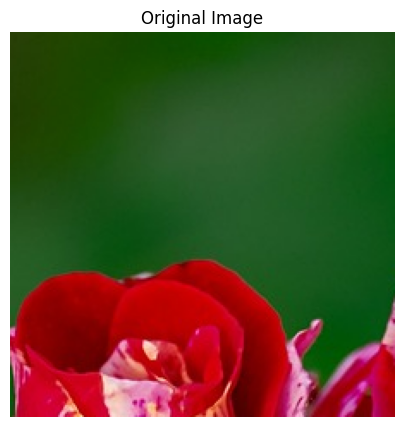

Step 00020. Loss:-106.54
Step 00040. Loss:-236.51
Step 00020. Loss:-75.38
Step 00040. Loss:-162.53
Step 00020. Loss:-41.69
Step 00040. Loss:-120.35
Step 00020. Loss:-91.24
Step 00040. Loss:-205.39
Step 00020. Loss:-69.87
Step 00040. Loss:-163.71
Step 00020. Loss:-113.06
Step 00040. Loss:-263.20
Step 00020. Loss:-53.34
Step 00040. Loss:-149.23
Step 00020. Loss:-50.46
Step 00040. Loss:-112.96
Step 00020. Loss:-86.77
Step 00040. Loss:-192.18
Step 00020. Loss:-95.01
Step 00040. Loss:-207.73


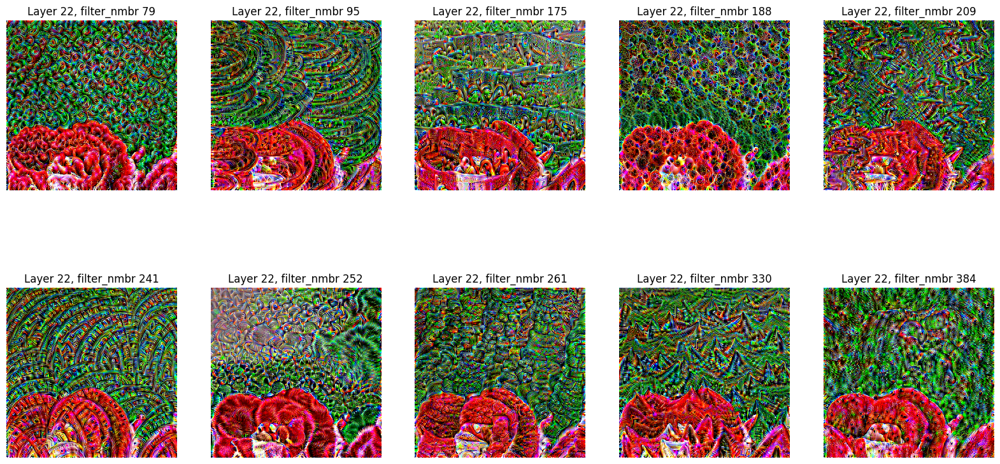

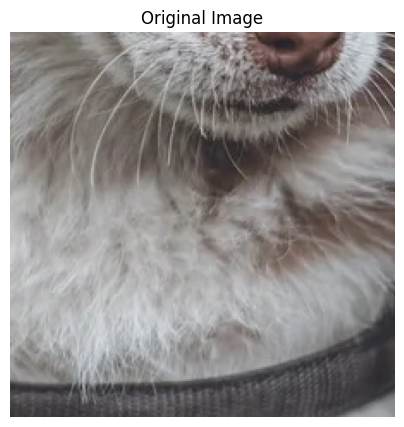

Step 00020. Loss:-109.71
Step 00040. Loss:-221.24
Step 00020. Loss:-101.93
Step 00040. Loss:-229.92
Step 00020. Loss:-70.29
Step 00040. Loss:-192.16
Step 00020. Loss:-115.48
Step 00040. Loss:-232.89
Step 00020. Loss:-163.23
Step 00040. Loss:-334.71
Step 00020. Loss:-105.67
Step 00040. Loss:-210.95
Step 00020. Loss:-146.38
Step 00040. Loss:-285.09
Step 00020. Loss:-68.91
Step 00040. Loss:-146.58
Step 00020. Loss:-75.67
Step 00040. Loss:-145.92
Step 00020. Loss:-75.09
Step 00040. Loss:-151.97


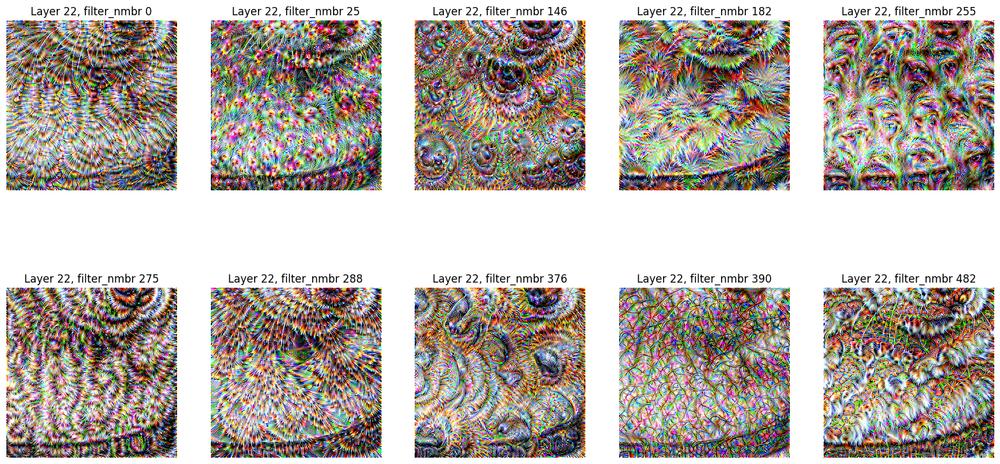

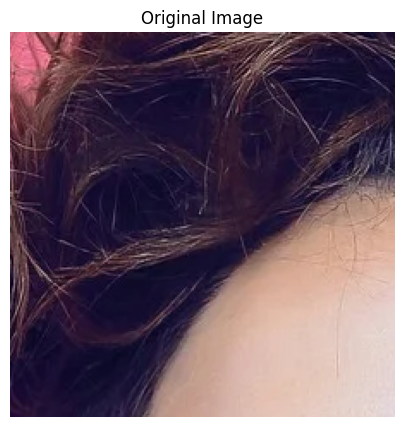

Step 00020. Loss:-135.19
Step 00040. Loss:-267.35
Step 00020. Loss:-73.06
Step 00040. Loss:-156.17
Step 00020. Loss:-193.21
Step 00040. Loss:-371.13
Step 00020. Loss:-122.34
Step 00040. Loss:-252.49
Step 00020. Loss:-117.59
Step 00040. Loss:-237.59
Step 00020. Loss:-97.63
Step 00040. Loss:-197.49
Step 00020. Loss:-14.04
Step 00040. Loss:-30.58
Step 00020. Loss:-143.43
Step 00040. Loss:-271.69
Step 00020. Loss:-68.06
Step 00040. Loss:-143.88
Step 00020. Loss:-123.53
Step 00040. Loss:-250.99


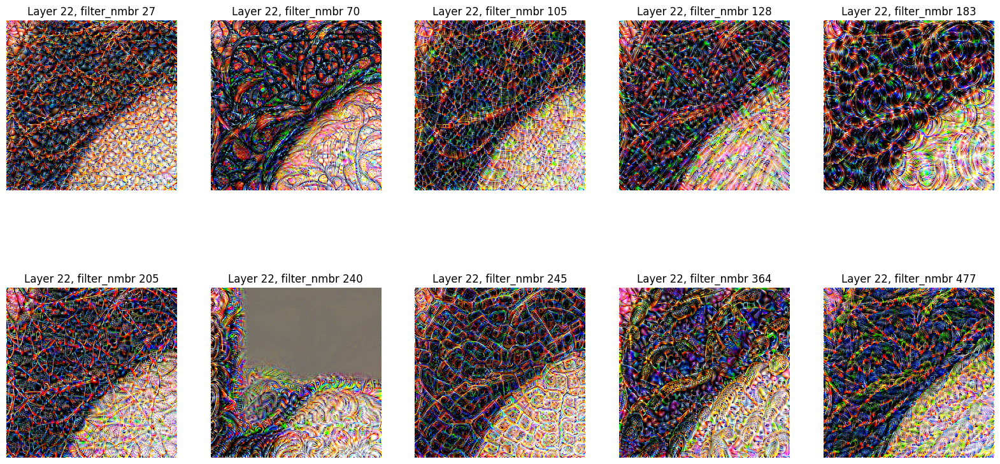

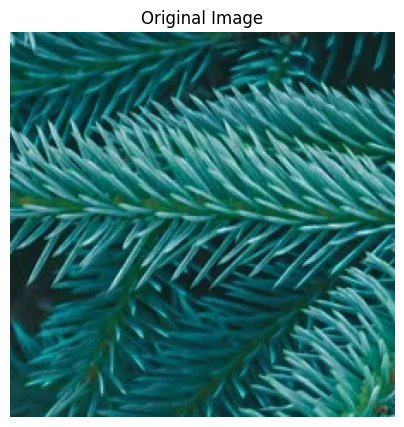

Step 00020. Loss:-110.12
Step 00040. Loss:-242.90
Step 00020. Loss:-87.32
Step 00040. Loss:-183.55
Step 00020. Loss:-157.54
Step 00040. Loss:-329.88
Step 00020. Loss:-109.13
Step 00040. Loss:-235.96
Step 00020. Loss:-161.20
Step 00040. Loss:-308.79
Step 00020. Loss:-23.40
Step 00040. Loss:-63.49
Step 00020. Loss:-129.49
Step 00040. Loss:-279.29
Step 00020. Loss:-105.12
Step 00040. Loss:-225.24
Step 00020. Loss:-194.51
Step 00040. Loss:-398.65
Step 00020. Loss:-140.97
Step 00040. Loss:-301.25


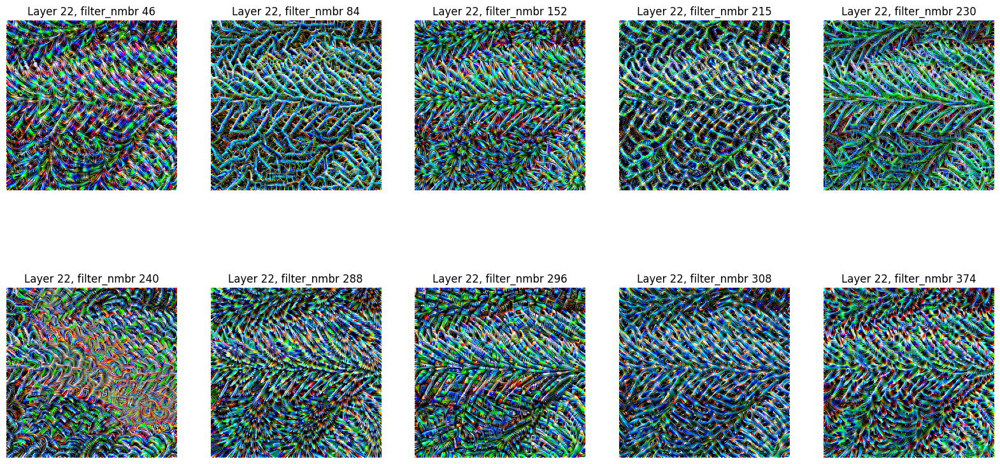

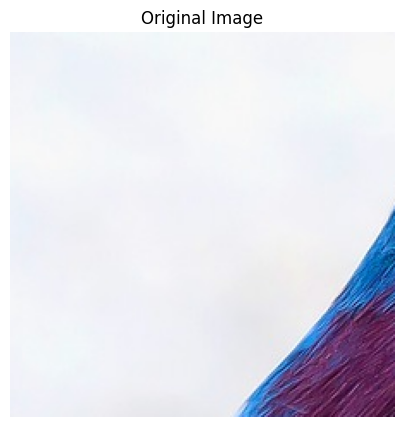

Step 00020. Loss:-62.89
Step 00040. Loss:-146.36
Step 00020. Loss:-81.81
Step 00040. Loss:-196.78
Step 00020. Loss:-33.82
Step 00040. Loss:-100.56
Step 00020. Loss:-35.02
Step 00040. Loss:-128.72
Step 00020. Loss:-44.60
Step 00040. Loss:-102.86
Step 00020. Loss:-54.28
Step 00040. Loss:-145.89
Step 00020. Loss:-68.69
Step 00040. Loss:-126.61
Step 00020. Loss:-59.31
Step 00040. Loss:-133.33
Step 00020. Loss:-60.71
Step 00040. Loss:-123.09
Step 00020. Loss:-61.14
Step 00040. Loss:-140.49


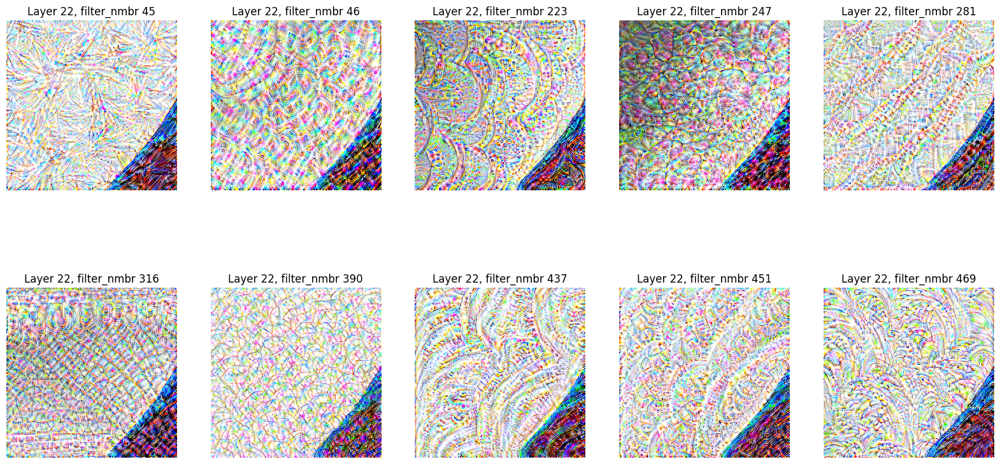

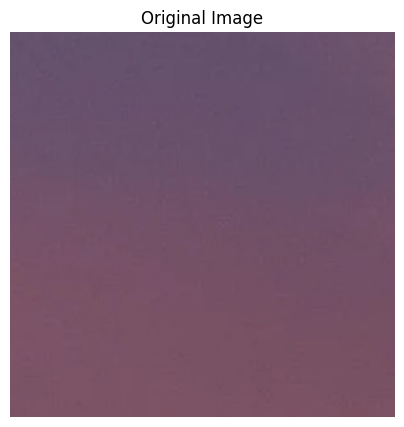

Step 00020. Loss:-93.04
Step 00040. Loss:-183.37
Step 00020. Loss:-86.39
Step 00040. Loss:-218.50
Step 00020. Loss:-128.61


KeyboardInterrupt: 

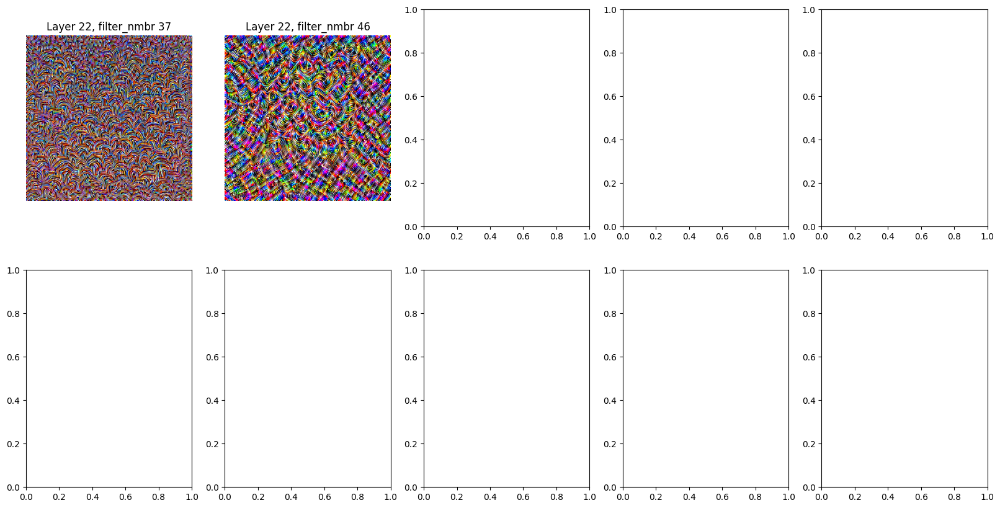

In [64]:
# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

for i, img in enumerate(images):
    optimized_img = visualise_10_most_activated_filters(model, img)

**What do you observe?**

In this exercise, we analyze the most activated filters for each unseen content image to gain insight into the features, textures, and elements that the neural network has learned to recognize. This is achieved through a technique called feature visualization or activation maximization.
The process involves using optimization techniques to generate or modify images that maximize the activation of specific filters in the pre-trained network. By visualizing the patterns that most strongly activate these filters, we can gain insight into the structures and features the network has learned to identify during training.

This visualization process is a one-to-many mapping, where each filter can be activated by several different patterns in the input image. By analyzing the top 10 most activated filters for each image, we can identify the _key features_ that are _most influential_ in the network's processing and classification decisions.

This exercise allows for a better understanding of the internal representations learned by the neural network and the hierarchical structure of features it uses to process and classify images. It provides valuable insights into how the network 'sees' and interprets visual information, enhancing our ability to interpret and debug these complex models.

## Task 1.2 Total variation loss.
One of the problems with the visualization of the filters
is that the optimization image becomes _too noisy_. In order to make the learned image more "natural", we are adding a regularization-term, namely total variation loss:
$$TV(I) = \sum_{i,j} \sqrt{|I_{i+1, j} - I_{i,j}|^2 + |I_{i,j+1} - I_{i,j}|^2}$$

We include this for our image-optimization-objective

$$I^* = \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmax}} \Big[\frac{1}{w\cdot h}\sum_{i,j} \phi(I)^{(\ell, f)}_{i,j} - \lambda\cdot TV(I)\Big]$$
$$= \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmin}} \Big[-\frac{1}{w\cdot h}\sum_{i,j} \phi(I)^{(\ell, f)}_{i,j}\Big + \lambda\cdot TV(I)\Big]$$


### Task 2.1: 5 images recreated with total variational (TV) loss

In [82]:
# Compare the neighbouring pixels via variational loss function
# Enhances additional image smoothness
layer_nmbr = 28
filter_nmbr = 6

collect_filters = []

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

for img in images:
    optimized_img = visualise_layer_filter(model, 
                                           layer_nmbr=layer_nmbr, 
                                           filter_nmbr=filter_nmbr, 
                                           num_optim_steps=32,
                                           rand_img=img, 
                                           total_var_loss=True)
    collect_filters.append(optimized_img)

Step 00020. Loss:8059430.50
Step 00020. Loss:5294140.50
Step 00020. Loss:6889169.50
Step 00020. Loss:8133442.00
Step 00020. Loss:9426560.00
Step 00020. Loss:4778902.50


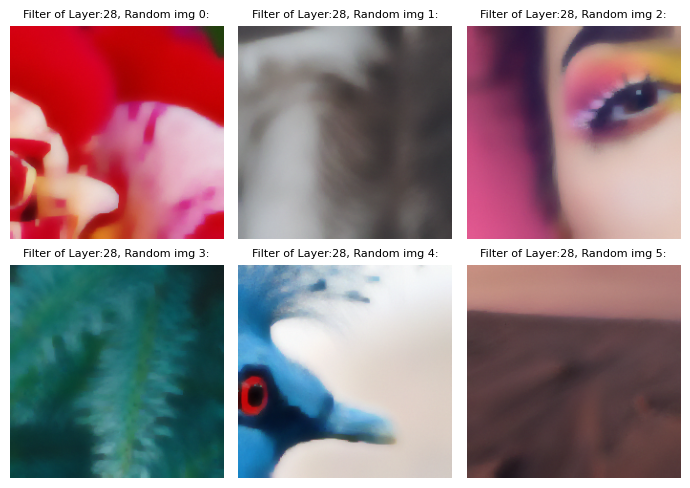

In [83]:
# Set the number of columns and rows
n_cols = 3
n = len(collect_filters)
n_rows = (n - 1) // n_cols + 1

plt_name = 'filter_grid_smooth_randimg.png'

# Plot filters in a grid
plt.figure(figsize=(7, 5))
for i, img in enumerate(collect_filters):
    # Adjust the subplot parameters to plot three images in one row
    plt.subplot(n_rows, n_cols, i + 1)
    plt.title('Filter of Layer:28, Random img {}:'.format(i), fontsize=8)
    plt.imshow(img, cmap='gray')
    plt.axis('off')

plt.tight_layout()
plt.savefig(os.path.join(RESULTS_DIR, plt_name))
plt.show()

### Task 2.1: 5 images recreated without additional total variational (TV) loss

In [84]:
# images without additional smoothness
collect_filters = []

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

for img in images:
    optimized_img = visualise_layer_filter(model, 
                                           layer_nmbr=layer_nmbr, 
                                           filter_nmbr=filter_nmbr, 
                                           num_optim_steps=32,
                                           rand_img=img, 
                                           total_var_loss=False)
    collect_filters.append(optimized_img)

Step 00020. Loss:-122.97
Step 00020. Loss:-110.32
Step 00020. Loss:-140.51
Step 00020. Loss:-109.07
Step 00020. Loss:-133.68
Step 00020. Loss:-145.81


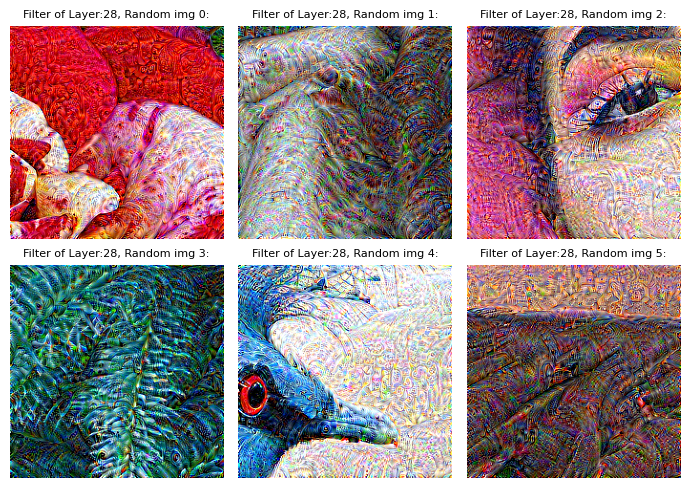

In [85]:
# Set the number of columns and rows
n_cols = 3
n = len(collect_filters)
n_rows = (n - 1) // n_cols + 1

plt_name = 'filter_grid_noSmooth_randimg.png'

# Plot filters in a grid
plt.figure(figsize=(7, 5))
for i, img in enumerate(collect_filters):
    # Adjust the subplot parameters to plot three images in one row
    plt.subplot(n_rows, n_cols, i + 1)
    plt.title('Filter of Layer:28, Random img {}:'.format(i), fontsize=8)
    plt.imshow(img, cmap='gray')
    plt.axis('off')

plt.tight_layout()
plt.savefig(os.path.join(RESULTS_DIR, plt_name))
plt.show()

## Task 1.3 - Deep Dream
Two important modifications:
1) Change the input image to a real photograph
2) Maximize activations of all the filters.For numerical stability you better use the $L_2$ norm of
the activations tensor and try to maximize this value during optimization.
--------------------------------------------------
For numerical stability, we once again adjust the optimization process:
$$I^* = \ \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmax}} \Big[ \| \phi(I)^{(\ell)} \|_2 - \lambda\cdot TV(I)\Big]$$
$$= \ \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmin}} \Big[ -\| \phi(I)^{(\ell)} \|_2 + \lambda\cdot TV(I)\Big]$$

In [114]:
def total_variation_loss(img, weight):
    # Calculate the total variation loss
    bs_img, c_img, h_img, w_img = img.size()
    tv_h = torch.pow(img[:,:,1:,:]-img[:,:,:-1,:], 2).sum()
    tv_w = torch.pow(img[:,:,:,1:]-img[:,:,:,:-1], 2).sum()
    return weight*(tv_h+tv_w)/(bs_img*c_img*h_img*w_img)

In [123]:
def deep_dream(model, layer_nmbr, input_image, num_optim_steps=50, lr=0.1, weight_decay=1e-6, tv_weight=20., device='cpu'):
    # Process image and return variable
    processed_image = preprocess_image(input_image, True)
    processed_image = torch.tensor(processed_image, device=device).float()
    processed_image.requires_grad = True
    # Define optimizer for the image
    optimizer = Adam([processed_image], lr=lr, weight_decay=weight_decay)
    
    for i in range(1, num_optim_steps):
        
        optimizer.zero_grad()
        
        # Assign create image to a variable to move forward in the model
        x = processed_image
        for index, layer in enumerate(model):
            # Forward pass layer by layer
            x = layer(x)
            if index == layer_nmbr:
                # Only need to forward until the selected layer is reached
                # Now, x is the output of the selected layer
                break
        
        conv_output = x[0]

        ######################################
        ####      Loss with L2 Norm       ####
        ######################################

        # 2) maximize activations of all the filters
        # Compute the L2 norm of the activations tensor
        # For numerical stability you better use the L2 norm of
        # the activations tensor and try to maximize this value during optimization.
        # Moreover, you need to add total variation loss and play with hyperparameters
        # a bit to obtain the best visual quality. The best performance is usually
        # achieved if you maximize activations not of one but of multiple layers. Try
        # this out as well and report results.
        
        # Compute the L2 norm of the activations tensor
        l2_norm = torch.sqrt(torch.sum(conv_output ** 2))
        # Compute the loss
        loss = -l2_norm
            
        # Add total variation loss later
        loss_tv = total_variation_loss(processed_image, weight=tv_weight)
        loss = loss + loss_tv

        if i % 20 == 0:
            print(f'Step {i:05d}. Loss:{loss.data.cpu().numpy():0.2f}')
        
        # Compute gradients
        loss.backward()
        # Apply gradients
        optimizer.step()
        # Recreate image
        optimized_image = recreate_image(processed_image.cpu())

        if i % 10 == 0:
            plt.figure(figsize=(3,3))
            plt.imshow(optimized_image)
            plt.title(f'Opt. Img. Step: {i:05d}')
            plt.show()

    return optimized_image


### Task 3.1 Experiment with small weight for TV loss

/Users/janinaalicamattes/miniforge3/envs/pytorch-py11/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/janinaalicamattes/miniforge3/envs/pytorch-py11/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/var/folders/4h/v0fwv1zs4596mmdvwj516k840000gn/T/ipykernel_83132/4117318541.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image =

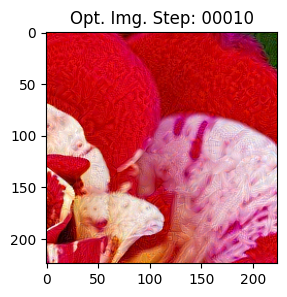

Step 00020. Loss:-3542.62


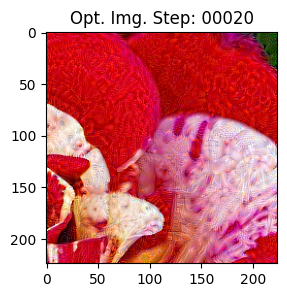

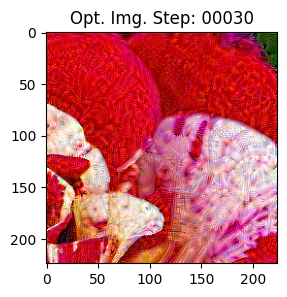

Step 00040. Loss:-6758.00


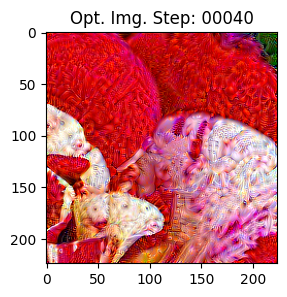

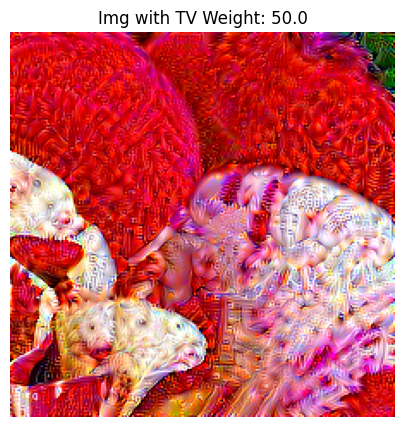

In [128]:
# images without additional smoothness
layer_nmbr=80
tv_weight = 50.
collect_filters = []

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

img = images[0]
rand_img = np.uint8(img)

out = deep_dream(model, layer_nmbr, rand_img, num_optim_steps=50, lr=0.05, tv_weight=tv_weight, device=device)

# Plot the image
plt.figure(figsize=(5,5))
plt.imshow(out)
plt.title(f'Img with TV Weight: {tv_weight}')
plt.axis('off')
plt.show()

**Task 3.2 Experiment with largegr weight for TV loss**

/var/folders/4h/v0fwv1zs4596mmdvwj516k840000gn/T/ipykernel_83132/4117318541.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


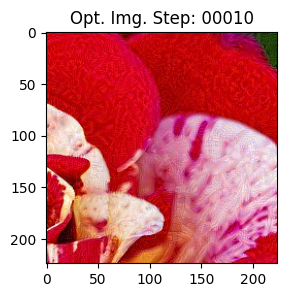

Step 00020. Loss:-3585.97


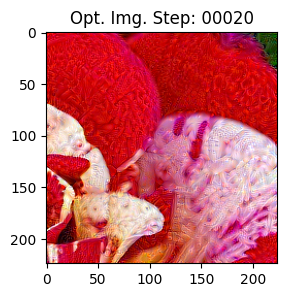

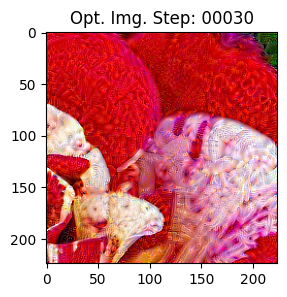

Step 00040. Loss:-6892.06


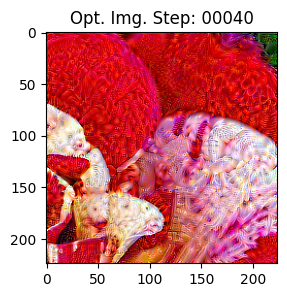

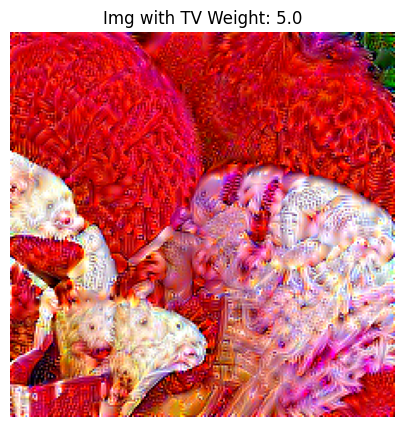

In [129]:
# images without additional smoothness
layer_nmbr=80
tv_weight = 5.
collect_filters = []

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()

img = images[0]
rand_img = np.uint8(img)

out = deep_dream(model, layer_nmbr, rand_img, num_optim_steps=50, lr=0.05, tv_weight=tv_weight, device=device)

# Plot the image
plt.figure(figsize=(5,5))
plt.imshow(out)
plt.title(f'Img with TV Weight: {tv_weight}')
plt.axis('off')
plt.show()

**What can you observe?**

* When using lower weights for the smoothing factor of the total variation loss (TV), the impact is minimal because the TV loss is not heavily emphasized in the optimization process. The primary focus is on minimizing the difference between the predicted output and the true output, which means the model is more concerned with accurately activating neurons of all layers than with producing a smooth image. As a result, the output image highlights the elements of the activation map that have the most significant impact on neuron activation (e.g. Huskey eye, or parts of the woman's auricle, cloud formation etc.).
* When using higher weights for the smoothing factor of the TV loss, the optimization process places more emphasis on producing a smooth image. The smoothing factor encourages neighboring pixels to have similar values, which can help to eliminate noise and reduce the appearance of artifacts in the image. However, this can also have the effect of blurring or distorting the image, particularly in areas where there are sharp changes in pixel values. In this case, the output image may be more cohesive and visually appealing, but it may also be less faithful to the original activation map.